
# 1. Инициализация преднастроенных нейросетевых моделей

In [1]:
from torchvision import models

alexNet = {
    # https://papers.nips.cc/paper/2012/hash/c399862d3b9d6b76c8436e924a68c45b-Abstract.html
    'model': models.alexnet(weights=models.AlexNet_Weights.DEFAULT),
    'weights': models.AlexNet_Weights.DEFAULT,
    'preprocess': models.AlexNet_Weights.DEFAULT.transforms(),
    'output_layer': 'classifier',
    'in_features': lambda model: model.classifier[1].in_features
}

resNet50 = {
    # https://arxiv.org/abs/1512.03385
    'model': models.resnet50(weights=models.ResNet50_Weights.DEFAULT),
    'weights': models.ResNet50_Weights.DEFAULT,
    'preprocess': models.ResNet50_Weights.DEFAULT.transforms(),
    'output_layer': 'fc',
    'in_features': lambda model: model.fc.in_features
}

denseNet = {
    # https://arxiv.org/abs/1608.06993
    'model': models.densenet201(weights=models.DenseNet201_Weights.DEFAULT),
    'weights': models.DenseNet201_Weights.DEFAULT,
    'preprocess': models.DenseNet201_Weights.DEFAULT.transforms(),
    'output_layer': 'classifier',
    'in_features': lambda model: model.classifier[0].in_features
}

mobileNetV3_small = {
    # https://arxiv.org/abs/1905.02244
    'model': models.mobilenet_v3_small(weights=models.mobilenetv3.MobileNet_V3_Small_Weights.DEFAULT),
    'weights': models.mobilenetv3.MobileNet_V3_Small_Weights.DEFAULT,
    'preprocess': models.mobilenetv3.MobileNet_V3_Small_Weights.DEFAULT.transforms(),
    'output_layer': 'classifier',
    'in_features': lambda model: model.classifier[0].in_features
}

swinT = {
    # https://arxiv.org/abs/2103.14030
    'model': models.swin_t(weights=models.Swin_T_Weights.IMAGENET1K_V1.DEFAULT),
    'weights': models.Swin_T_Weights.IMAGENET1K_V1.DEFAULT,
    'preprocess': models.Swin_T_Weights.IMAGENET1K_V1.DEFAULT.transforms(),
    'output_layer': 'head',
    'in_features': lambda model: model.head.in_features
}



Downloading: "https://download.pytorch.org/models/alexnet-owt-7be5be79.pth" to /root/.cache/torch/hub/checkpoints/alexnet-owt-7be5be79.pth
100%|██████████| 233M/233M [00:01<00:00, 143MB/s]
Downloading: "https://download.pytorch.org/models/resnet50-11ad3fa6.pth" to /root/.cache/torch/hub/checkpoints/resnet50-11ad3fa6.pth
100%|██████████| 97.8M/97.8M [00:00<00:00, 121MB/s]
Downloading: "https://download.pytorch.org/models/densenet201-c1103571.pth" to /root/.cache/torch/hub/checkpoints/densenet201-c1103571.pth
100%|██████████| 77.4M/77.4M [00:00<00:00, 90.3MB/s]
Downloading: "https://download.pytorch.org/models/mobilenet_v3_small-047dcff4.pth" to /root/.cache/torch/hub/checkpoints/mobilenet_v3_small-047dcff4.pth
100%|██████████| 9.83M/9.83M [00:00<00:00, 109MB/s]
Downloading: "https://download.pytorch.org/models/swin_t-704ceda3.pth" to /root/.cache/torch/hub/checkpoints/swin_t-704ceda3.pth
100%|██████████| 108M/108M [00:00<00:00, 141MB/s] 


Определимся с вычислительной подсистемой. Выберем среду с обучением на GPU

In [2]:
import torch

gpu = 'has' if torch.cuda.is_available() else 'has no'
print(f'Current environment {gpu} GPU support')
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
!lscpu
print(f'GPU count = {torch.cuda.device_count() if torch.cuda.is_available() else "0"}')

for model in [resNet50, alexNet, denseNet, mobileNetV3_small, swinT]:
    model['model'].to(device)
    model['preprocess'].to(device)
    model['model'].eval()

Current environment has GPU support
Architecture:             x86_64
  CPU op-mode(s):         32-bit, 64-bit
  Address sizes:          46 bits physical, 48 bits virtual
  Byte Order:             Little Endian
CPU(s):                   2
  On-line CPU(s) list:    0,1
Vendor ID:                GenuineIntel
  Model name:             Intel(R) Xeon(R) CPU @ 2.20GHz
    CPU family:           6
    Model:                79
    Thread(s) per core:   2
    Core(s) per socket:   1
    Socket(s):            1
    Stepping:             0
    BogoMIPS:             4399.99
    Flags:                fpu vme de pse tsc msr pae mce cx8 apic sep mtrr pge mca cmov pat pse36 cl
                          flush mmx fxsr sse sse2 ss ht syscall nx pdpe1gb rdtscp lm constant_tsc re
                          p_good nopl xtopology nonstop_tsc cpuid tsc_known_freq pni pclmulqdq ssse3
                           fma cx16 pcid sse4_1 sse4_2 x2apic movbe popcnt aes xsave avx f16c rdrand
                           hy

## Вспомогательные функции

In [3]:
import os
import time
import copy
import math

import typing
from typing import Callable
from functools import partial

import numpy
import pandas
from pandas.core.arrays import boolean
import matplotlib.pyplot as plt
from requests import get

from torch import Tensor, nn
from torch.utils.data import DataLoader, Dataset
from torchvision.transforms import ToPILImage, Compose, Resize, CenterCrop
from torchvision.io import read_image


strip_chars = ' \t'
tmp_file_name = 'tmp_file_name_for_image_download'

to_image = ToPILImage()


def classify(dataset: Dataset,
                preprocess: typing.Callable[[Tensor],Tensor],
                num_per_row: int, single_size: float,
                labels: typing.List[str],
                model_labels: typing.List[str] = None,
                model: typing.Callable[[Tensor], Tensor] = None,
                debug: typing.Any = False,
                num_of_classes: int = 1,
                vspace: float = 0.3
             ) -> None:
    num = len(dataset)
    fig, axs = plt.subplots(math.ceil(num/num_per_row), num_per_row, figsize=(
        single_size*num_per_row, (single_size + vspace)*(math.ceil(num/num_per_row))),
        sharex=True, sharey=True)
    detection_time = []
    for i in range(0, len(dataset)):
        try:
            image, label = dataset[i]
            pred = None

            if model is not None and model_labels is not None:
                start_time = time.perf_counter_ns()
                score = model(image.unsqueeze(0)).detach().squeeze(0).softmax(0)
                pred_index = numpy.flip(score.detach().cpu().argsort().numpy())[0]
                end_time = time.perf_counter_ns()
                detection_time.append((end_time - start_time) / 1_000_000)
                pred = f'Detector: {(end_time - start_time) / 1_000_000:.0f}ms\n{model_labels[pred_index]}[{score[pred_index].item()*100:.0f}%]'

            loc_fig = axs[i//num_per_row, i % num_per_row]
            loc_fig.imshow(to_image(preprocess(image)))
            title =f'\nActual: {labels[label]}[{label}]\n{pred}'
            loc_fig.title.set_text(title)
        except Exception as ex:
          if debug:
              raise ex
          print(f'Image {i} is failed to load: {str(ex)}')


    fig.subplots_adjust(wspace=0.3)
    plt.show()
    return detection_time


def denormalize(dataset: Dataset, trans: typing.Any) -> Callable[[Tensor], Tensor]:
    image, label = dataset[0]
    std = torch.as_tensor(trans.std, dtype=image.dtype, device=image.device).view(-1, 1, 1)
    mean = torch.as_tensor(trans.mean, dtype=image.dtype, device=image.device).view(-1, 1, 1)
    return lambda img: img*std + mean


class UrlDataset(Dataset):

    def __init__(self, file: str, to_device, transform = None) -> None:
        self.file = file
        self.transform = transform
        self.dataset = pandas.read_csv(file, sep=';')
        self.classes = self.dataset['label'].unique()
        self.classes.sort()
        self.class_to_index = {self.classes[i] : i for i in range(len(self.classes))}
        self.device = to_device

    def __len__(self) -> int:
        return len(self.dataset)

    def __getitem__(self, index: int) -> typing.Tuple[torch.Tensor, str]:
        url = self.dataset.iloc[index]['url'].strip(strip_chars)
        with open(tmp_file_name, 'wb') as file:
            file.write(get(url).content)
        image = read_image(tmp_file_name).to(self.device)
        label = self.class_to_index[self.dataset.iloc[index]['label']]
        if self.transform:
            return self.transform(image), label
        return image, label


def train_model(model, dataloader: DataLoader, device: torch.device,
                critery, optimizer, scheduler, num_epochs=25):
    since = time.time()

    best_model_wts = copy.deepcopy(model.state_dict())
    best_loss = 0.0
    best_epoch = -1

    process = {'train': {'loss': [], 'accuracy': []}, 'validate': {'loss': [], 'accuracy': []}}

    for epoch in range(num_epochs):
        print(f'Epoch {epoch}/{num_epochs - 1}')
        print('-' * 10)
        epoch_loss = 0.0
        epoch_acc = 0.0
        for item in dataloader:
            if item['train'] == True:
                model.train()
            else:
                model.eval()
            running_loss = 0.0
            running_corrects = 0
            dataset_size = 0
            for inputs, labels in item['loader']:
                dataset_size = dataset_size + 1
                inputs = inputs.to(device)
                labels = labels.to(device)
                optimizer.zero_grad()
                with torch.set_grad_enabled(item['train'] == True):
                    outputs = model(inputs)
                    _, preds = torch.max(outputs, 1)
                    loss = critery(outputs, labels)
                    if item['train'] == True:
                        loss.backward()
                        optimizer.step()
                running_loss += loss.item() * inputs.size(0)
                running_corrects += torch.sum(preds == labels.data)
            if item['train'] == True:
                scheduler.step()

            epoch_loss = running_loss / dataset_size
            epoch_acc = running_corrects.detach().cpu().double() / dataset_size

            if item['train'] == True:
                ptype = 'train'
            else:
                ptype = 'validate'

            process[ptype]['loss'].append(epoch_loss)
            process[ptype]['accuracy'].append(epoch_acc)

            print(f'[{epoch}][train={item["train"]}] Loss: {epoch_loss:.4f} Acc: {epoch_acc:.4f}')

            # deep copy the model
            if item['train'] == True and 1/epoch_loss > best_loss:
                best_loss = 1/epoch_loss
                best_model_wts = copy.deepcopy(model.state_dict())
                best_epoch = epoch

        print()

    time_elapsed = time.time() - since
    print(f'Training complete in {time_elapsed // 60:.0f}m {time_elapsed % 60:.0f}s')
    print(f'Best val loss: {1/best_loss:4f} at epoch {best_epoch}')

    # load best model weights
    model.load_state_dict(best_model_wts)
    return model, process

## Подготовка датасета для проверки возможностей моделей

Найдем изображения соответствующие варианту № 1 (погрузчик и экскаватор), загрузим в репозиторий, чтобы не зависеть от работы сайтов, где были найдены изображения.

In [4]:
%%writefile simple.csv
label;url
loader;https://github.com/Hailrave/NN/blob/main/dataset_raw/loader/1.jpeg?raw=true
loader;https://github.com/Hailrave/NN/blob/main/dataset_raw/loader/2.jpg?raw=true
loader;https://github.com/Hailrave/NN/blob/main/dataset_raw/loader/3.jpg?raw=true
loader;https://github.com/Hailrave/NN/blob/main/dataset_raw/loader/4.jpg?raw=true
loader;https://github.com/Hailrave/NN/blob/main/dataset_raw/loader/5.jpg?raw=true
loader;https://github.com/Hailrave/NN/blob/main/dataset_raw/loader/6.jpg?raw=true
loader;https://github.com/Hailrave/NN/blob/main/dataset_raw/loader/7.jpg?raw=true
loader;https://github.com/Hailrave/NN/blob/main/dataset_raw/loader/8.jpg?raw=true
loader;https://github.com/Hailrave/NN/blob/main/dataset_raw/loader/9.jpg?raw=true
loader;https://github.com/Hailrave/NN/blob/main/dataset_raw/loader/10.jpg?raw=true
loader;https://github.com/Hailrave/NN/blob/main/dataset_raw/loader/11.jpg?raw=true
loader;https://github.com/Hailrave/NN/blob/main/dataset_raw/loader/12.jpg?raw=true
loader;https://github.com/Hailrave/NN/blob/main/dataset_raw/loader/13.jpg?raw=true
loader;https://github.com/Hailrave/NN/blob/main/dataset_raw/loader/14.jpg?raw=true
loader;https://github.com/Hailrave/NN/blob/main/dataset_raw/loader/15.jpg?raw=true
loader;https://github.com/Hailrave/NN/blob/main/dataset_raw/loader/16.jpg?raw=true
loader;https://github.com/Hailrave/NN/blob/main/dataset_raw/loader/17.jpg?raw=true
loader;https://github.com/Hailrave/NN/blob/main/dataset_raw/loader/18.jpg?raw=true
loader;https://github.com/Hailrave/NN/blob/main/dataset_raw/loader/19.jpg?raw=true
loader;https://github.com/Hailrave/NN/blob/main/dataset_raw/loader/20.jpg?raw=true
loader;https://github.com/Hailrave/NN/blob/main/dataset_raw/loader/21.jpg?raw=true
loader;https://github.com/Hailrave/NN/blob/main/dataset_raw/loader/22.jpg?raw=true
loader;https://github.com/Hailrave/NN/blob/main/dataset_raw/loader/23.jpg?raw=true
loader;https://github.com/Hailrave/NN/blob/main/dataset_raw/loader/24.jpg?raw=true
loader;https://github.com/Hailrave/NN/blob/main/dataset_raw/loader/25.jpeg?raw=true
excavator;https://github.com/Hailrave/NN/blob/main/dataset_raw/excavator/1.jpg?raw=true
excavator;https://github.com/Hailrave/NN/blob/main/dataset_raw/excavator/2.jpg?raw=true
excavator;https://github.com/Hailrave/NN/blob/main/dataset_raw/excavator/3.jpg?raw=true
excavator;https://github.com/Hailrave/NN/blob/main/dataset_raw/excavator/4.jpg?raw=true
excavator;https://github.com/Hailrave/NN/blob/main/dataset_raw/excavator/5.jpeg?raw=true
excavator;https://github.com/Hailrave/NN/blob/main/dataset_raw/excavator/6.jpg?raw=true
excavator;https://github.com/Hailrave/NN/blob/main/dataset_raw/excavator/7.jpg?raw=true
excavator;https://github.com/Hailrave/NN/blob/main/dataset_raw/excavator/8.jpg?raw=true
excavator;https://github.com/Hailrave/NN/blob/main/dataset_raw/excavator/9.jpg?raw=true
excavator;https://github.com/Hailrave/NN/blob/main/dataset_raw/excavator/10.jpg?raw=true
excavator;https://github.com/Hailrave/NN/blob/main/dataset_raw/excavator/11.jpg?raw=true
excavator;https://github.com/Hailrave/NN/blob/main/dataset_raw/excavator/12.jpg?raw=true
excavator;https://github.com/Hailrave/NN/blob/main/dataset_raw/excavator/13.jpg?raw=true
excavator;https://github.com/Hailrave/NN/blob/main/dataset_raw/excavator/14.jpg?raw=true
excavator;https://github.com/Hailrave/NN/blob/main/dataset_raw/excavator/15.jpg?raw=true
excavator;https://github.com/Hailrave/NN/blob/main/dataset_raw/excavator/16.jpg?raw=true
excavator;https://github.com/Hailrave/NN/blob/main/dataset_raw/excavator/17.jpg?raw=true
excavator;https://github.com/Hailrave/NN/blob/main/dataset_raw/excavator/18.jpg?raw=true
excavator;https://github.com/Hailrave/NN/blob/main/dataset_raw/excavator/19.jpeg?raw=true
excavator;https://github.com/Hailrave/NN/blob/main/dataset_raw/excavator/20.jpg?raw=true
excavator;https://github.com/Hailrave/NN/blob/main/dataset_raw/excavator/21.jpg?raw=true
excavator;https://github.com/Hailrave/NN/blob/main/dataset_raw/excavator/22.jpg?raw=true
excavator;https://github.com/Hailrave/NN/blob/main/dataset_raw/excavator/23.jpg?raw=true
excavator;https://github.com/Hailrave/NN/blob/main/dataset_raw/excavator/24.jpg?raw=true
excavator;https://github.com/Hailrave/NN/blob/main/dataset_raw/excavator/25.jpg?raw=true

Writing simple.csv


Модифицируем код, добавим метрики для сбора информации о времени распознания изображений для дальнейшего сравнительного анализа моделей и CPU vs GPU.

----------------------------------------------------------------------
Model: AlexNet
Number of parameters: 61100840


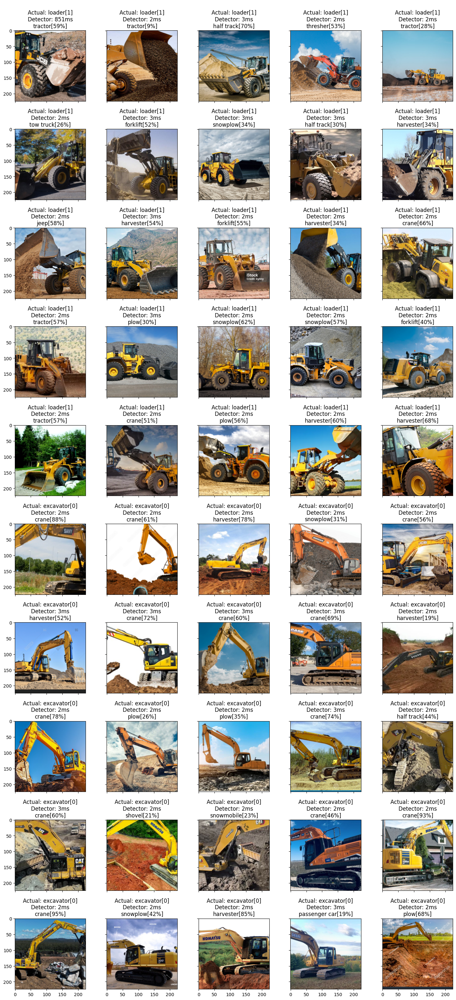

{'AlexNet': 19.449645299999997}
----------------------------------------------------------------------
Model: ResNet
Number of parameters: 25557032


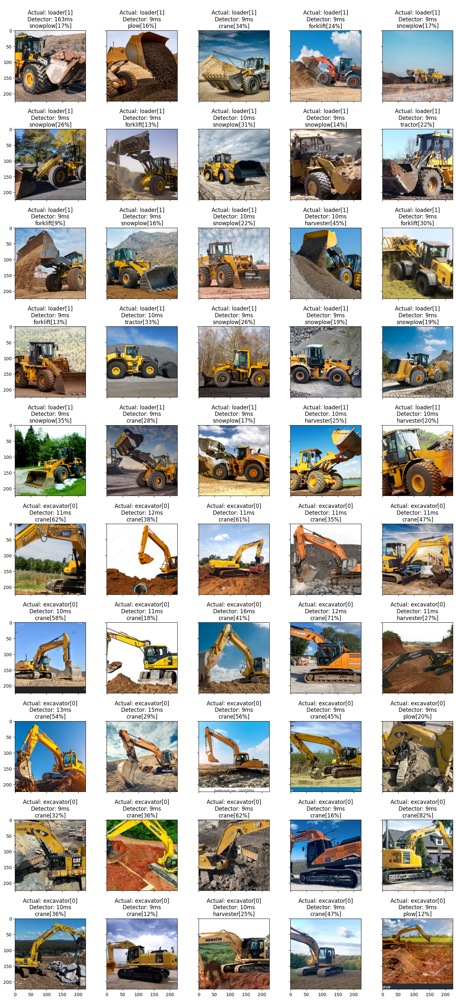

{'AlexNet': 19.449645299999997, 'ResNet': 13.101980059999999}
----------------------------------------------------------------------
Model: DenseNet
Number of parameters: 20013928


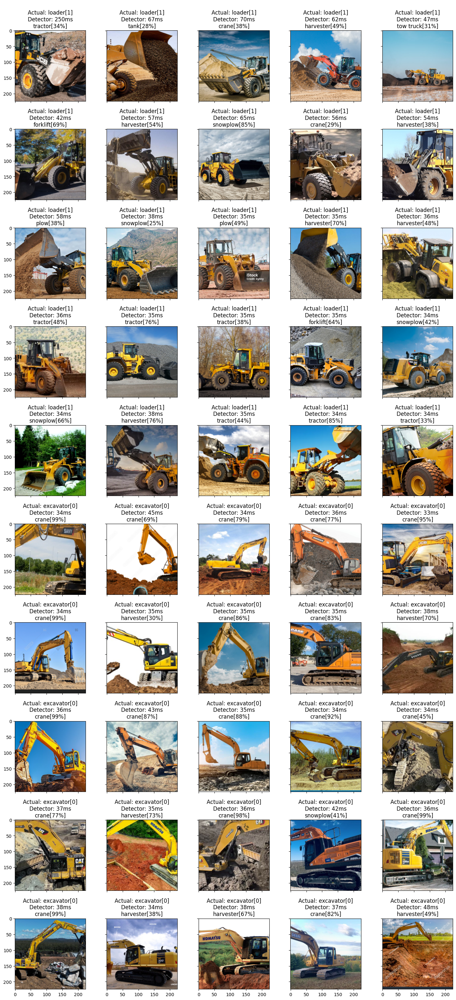

{'AlexNet': 19.449645299999997, 'ResNet': 13.101980059999999, 'DenseNet': 44.789602680000016}
----------------------------------------------------------------------
Model: MobileNetV3
Number of parameters: 2542856


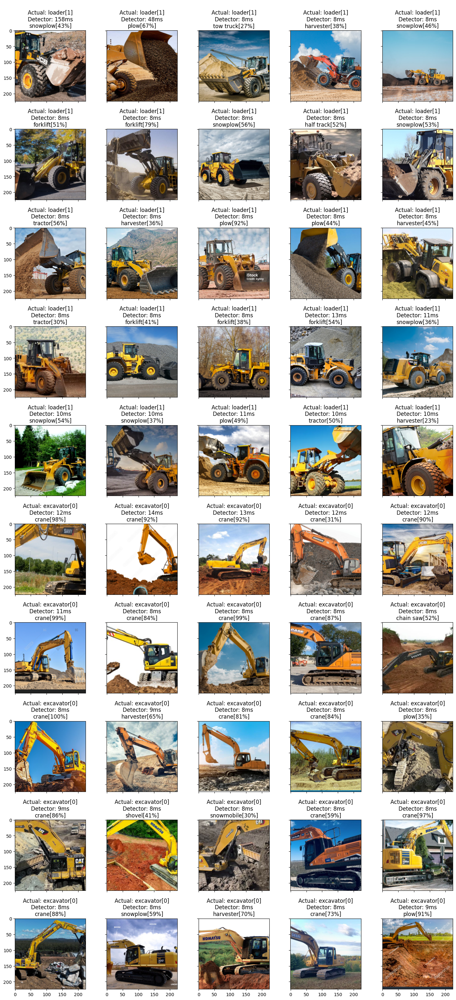

{'AlexNet': 19.449645299999997, 'ResNet': 13.101980059999999, 'DenseNet': 44.789602680000016, 'MobileNetV3': 12.762378299999998}
----------------------------------------------------------------------
Model: SwinTransformer
Number of parameters: 28288354


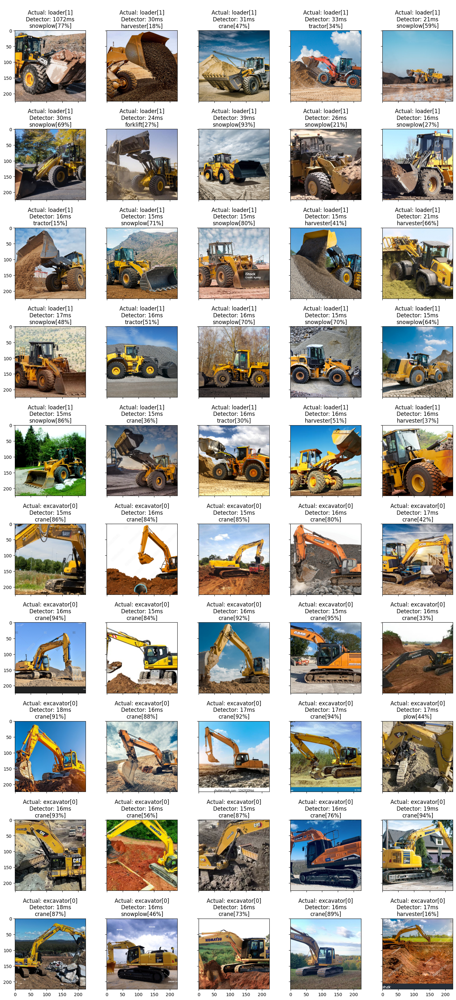

{'AlexNet': 19.449645299999997, 'ResNet': 13.101980059999999, 'DenseNet': 44.789602680000016, 'MobileNetV3': 12.762378299999998, 'SwinTransformer': 39.42325216000002}


In [5]:
avg_times = {}
detection_times = {}
for model in [alexNet, resNet50, denseNet, mobileNetV3_small, swinT]:
  transform = model['preprocess']
  simple = UrlDataset("simple.csv", device, transform)
  print('-'*70)
  print(f'Model: { model["model"].__class__.__name__}')
  print(f'Number of parameters: {sum(item.numel() for item in model["model"].parameters())}')
  num_per_row = 5
  single_size = 3.5
  vspace = 0.4

  detection_time = classify(simple, denormalize(simple, transform), num_per_row=num_per_row, single_size=single_size, vspace = vspace,
              labels = simple.classes, model=model['model'], model_labels=model['weights'].meta["categories"],
              debug=True)

  avg_time = sum(detection_time) / len(detection_time)

  detection_times[model["model"].__class__.__name__] = detection_time
  avg_times[model["model"].__class__.__name__] = avg_time
  print(avg_times)

По результатам полученным из набора моделей видим, что ни одна модель не настроена на распознавания погрузчика или экскаватора, возможно подобные классы изображений попросту отсутствуют.

Выведем графики сравнения скорости распознавания изображений на GPU среди моделей.

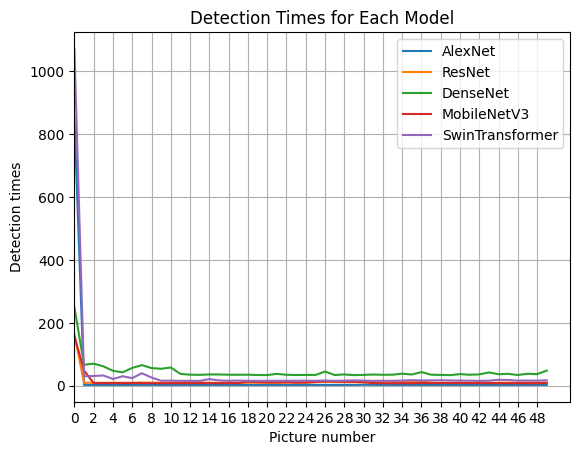

In [6]:
for model, times in detection_times.items() :
  plt.plot(range(len(times)), times, label=model)

plt.xlabel('Picture number')
plt.xlim(left=0)
plt.ylabel('Detection times')
plt.title('Detection Times for Each Model')
plt.legend()
plt.grid()
step = 2
plt.xticks(range(0, len(times), step))
plt.show()

График из другого файла, где среда выполнения была CPU:

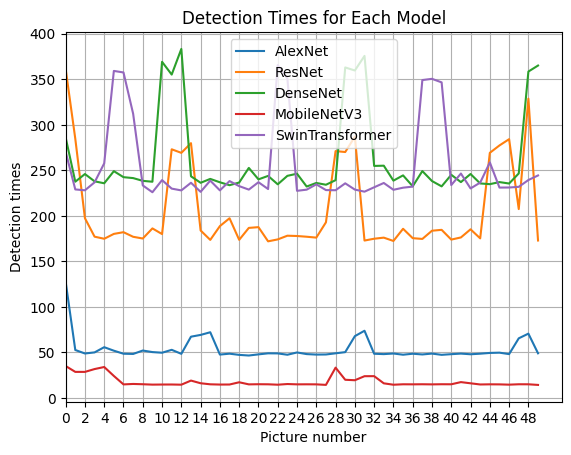

По графикам видно, что на GPU скорость выполнения моделей существенно выше

Сначала выполним в среде CPU, скопируем оттуда данные и приведем их в этом графике, сравнивая скорость на CPU и GPU

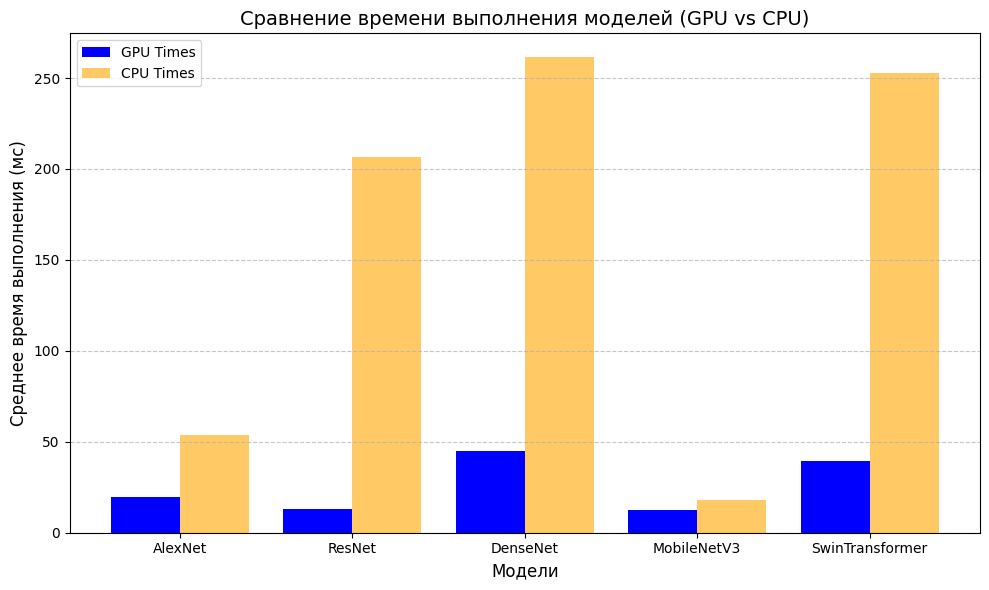

In [7]:
# Данные из среды выполнения cpu
avg_times_cpu = {'AlexNet': 53.50087253999999, 'ResNet': 206.34151312000006, 'DenseNet': 261.50472413999995, 'MobileNetV3': 17.90893566, 'SwinTransformer': 252.92170008000002}

models = list(avg_times.keys())
cpu_times = list(avg_times_cpu.values())
gpu_times = list(avg_times.values())

bar_width = 0.4
x_indices = range(len(models))

plt.figure(figsize=(10, 6))
plt.bar(x_indices, gpu_times, width=bar_width, color='blue', label='GPU Times')
plt.bar([x + bar_width for x in x_indices], cpu_times, width=bar_width,
        color='orange', alpha=0.6, label='CPU Times')

plt.title("Сравнение времени выполнения моделей (GPU vs CPU)", fontsize=14)
plt.xlabel("Модели", fontsize=12)
plt.ylabel("Среднее время выполнения (мс)", fontsize=12)
plt.xticks([x + bar_width / 2 for x in x_indices], models, fontsize=10)
plt.yticks(fontsize=10)
plt.grid(axis="y", linestyle="--", alpha=0.7)
plt.legend(fontsize=10)

plt.tight_layout()
plt.show()

# Подготовка датасета для донастройки модели

Разобьем датасет на тренировочный и тестовый сеты.

In [ ]:
%%writefile train.csv
label;url
loader;https://github.com/Hailrave/NN/blob/main/dataset_raw/loader/1.jpeg?raw=true
loader;https://github.com/Hailrave/NN/blob/main/dataset_raw/loader/2.jpg?raw=true
loader;https://github.com/Hailrave/NN/blob/main/dataset_raw/loader/3.jpg?raw=true
loader;https://github.com/Hailrave/NN/blob/main/dataset_raw/loader/4.jpg?raw=true
loader;https://github.com/Hailrave/NN/blob/main/dataset_raw/loader/5.jpg?raw=true
loader;https://github.com/Hailrave/NN/blob/main/dataset_raw/loader/6.jpg?raw=true
loader;https://github.com/Hailrave/NN/blob/main/dataset_raw/loader/7.jpg?raw=true
loader;https://github.com/Hailrave/NN/blob/main/dataset_raw/loader/8.jpg?raw=true
loader;https://github.com/Hailrave/NN/blob/main/dataset_raw/loader/9.jpg?raw=true
loader;https://github.com/Hailrave/NN/blob/main/dataset_raw/loader/10.jpg?raw=true
loader;https://github.com/Hailrave/NN/blob/main/dataset_raw/loader/11.jpg?raw=true
loader;https://github.com/Hailrave/NN/blob/main/dataset_raw/loader/12.jpg?raw=true
loader;https://github.com/Hailrave/NN/blob/main/dataset_raw/loader/13.jpg?raw=true
loader;https://github.com/Hailrave/NN/blob/main/dataset_raw/loader/14.jpg?raw=true
loader;https://github.com/Hailrave/NN/blob/main/dataset_raw/loader/15.jpg?raw=true
loader;https://github.com/Hailrave/NN/blob/main/dataset_raw/loader/16.jpg?raw=true
loader;https://github.com/Hailrave/NN/blob/main/dataset_raw/loader/17.jpg?raw=true
loader;https://github.com/Hailrave/NN/blob/main/dataset_raw/loader/18.jpg?raw=true
loader;https://github.com/Hailrave/NN/blob/main/dataset_raw/loader/19.jpg?raw=true
loader;https://github.com/Hailrave/NN/blob/main/dataset_raw/loader/20.jpg?raw=true
excavator;https://github.com/Hailrave/NN/blob/main/dataset_raw/excavator/1.jpg?raw=true
excavator;https://github.com/Hailrave/NN/blob/main/dataset_raw/excavator/2.jpg?raw=true
excavator;https://github.com/Hailrave/NN/blob/main/dataset_raw/excavator/3.jpg?raw=true
excavator;https://github.com/Hailrave/NN/blob/main/dataset_raw/excavator/4.jpg?raw=true
excavator;https://github.com/Hailrave/NN/blob/main/dataset_raw/excavator/5.jpeg?raw=true
excavator;https://github.com/Hailrave/NN/blob/main/dataset_raw/excavator/6.jpg?raw=true
excavator;https://github.com/Hailrave/NN/blob/main/dataset_raw/excavator/7.jpg?raw=true
excavator;https://github.com/Hailrave/NN/blob/main/dataset_raw/excavator/8.jpg?raw=true
excavator;https://github.com/Hailrave/NN/blob/main/dataset_raw/excavator/9.jpg?raw=true
excavator;https://github.com/Hailrave/NN/blob/main/dataset_raw/excavator/10.jpg?raw=true
excavator;https://github.com/Hailrave/NN/blob/main/dataset_raw/excavator/11.jpg?raw=true
excavator;https://github.com/Hailrave/NN/blob/main/dataset_raw/excavator/12.jpg?raw=true
excavator;https://github.com/Hailrave/NN/blob/main/dataset_raw/excavator/13.jpg?raw=true
excavator;https://github.com/Hailrave/NN/blob/main/dataset_raw/excavator/14.jpg?raw=true
excavator;https://github.com/Hailrave/NN/blob/main/dataset_raw/excavator/15.jpg?raw=true
excavator;https://github.com/Hailrave/NN/blob/main/dataset_raw/excavator/16.jpg?raw=true
excavator;https://github.com/Hailrave/NN/blob/main/dataset_raw/excavator/17.jpg?raw=true
excavator;https://github.com/Hailrave/NN/blob/main/dataset_raw/excavator/18.jpg?raw=true
excavator;https://github.com/Hailrave/NN/blob/main/dataset_raw/excavator/19.jpeg?raw=true
excavator;https://github.com/Hailrave/NN/blob/main/dataset_raw/excavator/20.jpg?raw=true

Overwriting train.csv


In [ ]:
%%writefile test.csv
label;url
loader;https://github.com/Hailrave/NN/blob/main/dataset_raw/loader/21.jpg?raw=true
loader;https://github.com/Hailrave/NN/blob/main/dataset_raw/loader/22.jpg?raw=true
loader;https://github.com/Hailrave/NN/blob/main/dataset_raw/loader/23.jpg?raw=true
loader;https://github.com/Hailrave/NN/blob/main/dataset_raw/loader/24.jpg?raw=true
loader;https://github.com/Hailrave/NN/blob/main/dataset_raw/loader/25.jpeg?raw=true
excavator;https://github.com/Hailrave/NN/blob/main/dataset_raw/excavator/21.jpg?raw=true
excavator;https://github.com/Hailrave/NN/blob/main/dataset_raw/excavator/22.jpg?raw=true
excavator;https://github.com/Hailrave/NN/blob/main/dataset_raw/excavator/23.jpg?raw=true
excavator;https://github.com/Hailrave/NN/blob/main/dataset_raw/excavator/24.jpg?raw=true
excavator;https://github.com/Hailrave/NN/blob/main/dataset_raw/excavator/25.jpg?raw=true

Writing test.csv


----------------------------------------------------------------------
Model: ResNet
Number of parameters: 25557032
------------------------------ Train dataset ------------------------------


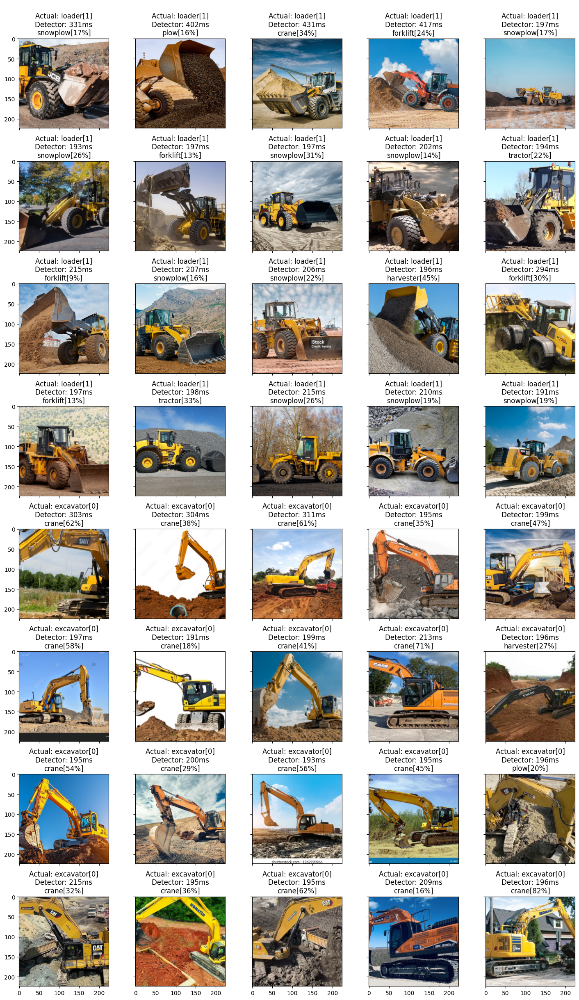

------------------------------ Test dataset ------------------------------


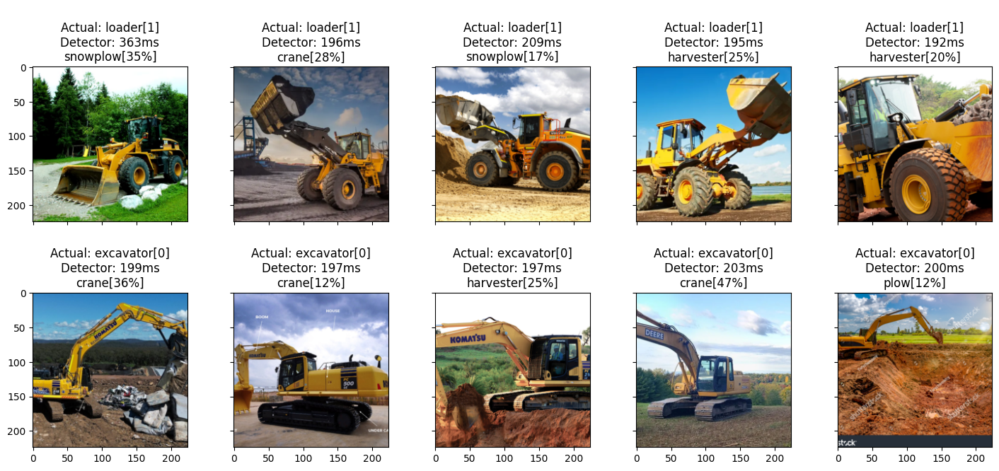

In [ ]:
transform = model['preprocess']
train = UrlDataset("train.csv", device, transform)
test = UrlDataset('test.csv', device, transform)

num_per_row = 5
single_size = 3.5
vspace = 0.3

print('-'*70)
print(f'Model: { model["model"].__class__.__name__}')
print(f'Number of parameters: {sum(item.numel() for item in model["model"].parameters())}')

print('-'*30  + ' Train dataset ' + '-'*30)
classify(train, denormalize(train, transform), num_per_row=num_per_row, single_size=single_size, vspace=vspace,
            labels = train.classes, model=model['model'], model_labels=model['weights'].meta["categories"])
print('-'*30  + ' Test dataset ' + '-'*30)
classify(test, denormalize(test, transform), num_per_row=num_per_row, single_size=single_size, vspace=vspace,
            labels = test.classes, model=model['model'], model_labels=model['weights'].meta["categories"])

# Дообучение

Дообучение предобученной модели мы будем проводить, отключив перенастройку и переобучение предобученных слоев. Нам неоюходимо добавить новый слой-классификатор, переобучая выходные слои модели.

In [ ]:
print(model)

{'model': ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), s

Добавим новый слой-классификатор на выходе

In [ ]:
image, label = simple[0]
feature_extractor = copy.deepcopy(model['model'])
result = feature_extractor(image.unsqueeze(0)).cpu().detach().squeeze(0).numpy()
print(f'Размерность выходов исходной модели: {result.shape}')
setattr(feature_extractor, model['output_layer'], nn.Identity())
result = feature_extractor(image.unsqueeze(0)).cpu().detach().squeeze(0).numpy()
print(f'Размерность выходов модели после замены выходного классификатора на единичное преобразование: {result.shape}')

Размерность выходов исходной модели: (1000,)
Размерность выходов модели после замены выходного классификатора на единичное преобразование: (2048,)


In [ ]:
output = []
for image, label in torch.utils.data.ConcatDataset([train, test]):
    result = {'label': label, 'feature': feature_extractor(image.unsqueeze(0)).cpu().detach().squeeze(0).numpy()}
    output.append(result)
features = numpy.concatenate([numpy.expand_dims(record['feature'], 0) for record in output])
labels = [record['label'] for i, record in enumerate(output)]

In [ ]:
totalU, totalS, totalV = torch.pca_lowrank(torch.from_numpy(features), q=2)

Приведём визуализацию классификации.

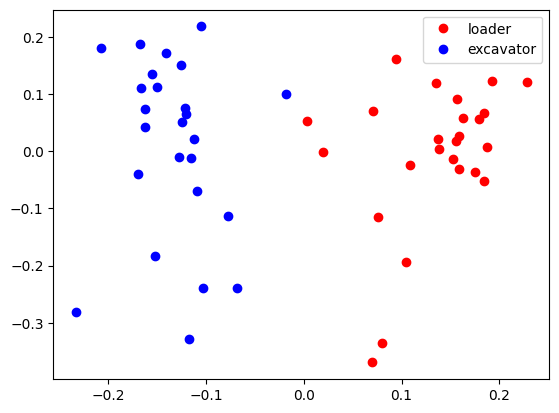

In [ ]:
series = {}
for key in ['loader', 'excavator']:
    points = numpy.concatenate([numpy.expand_dims(totalU[i,:].cpu().detach().numpy(), 0)
        for i, label in enumerate(labels) if train.classes[label] == key])
    series[key] = numpy.moveaxis(points, 1, 0)

plt.figure()
plt.plot(series['loader'][0], series['loader'][1], 'ro', series['excavator'][0], series['excavator'][1], 'bo')
plt.legend(['loader', 'excavator'])
plt.show()

На графике довольно явно видны 2 класса, которые можно линейно "разделить".

In [ ]:
tunned_model = copy.deepcopy(model['model'])
for param in tunned_model.parameters():
    param.requires_grad = False

In [ ]:
print(getattr(tunned_model, model['output_layer']))

Linear(in_features=2048, out_features=1000, bias=True)


In [ ]:
in_features = model['in_features'](tunned_model)
print(in_features)

2048


In [ ]:
setattr(tunned_model, model['output_layer'], torch.nn.Sequential(torch.nn.Linear(in_features, 2), torch.nn.Softmax(dim=1)))

In [ ]:
print(f"num of adjustable parameters = {sum(i.numel() for i in getattr(tunned_model, model['output_layer']).parameters())}")

num of adjustable parameters = 4098


In [ ]:
dataloader = [
    {
        'train': True,
        'loader': DataLoader(train, batch_size=1, shuffle=True, num_workers=0)
    },
    {
        'train': False,
        'loader': DataLoader(test, batch_size=1, shuffle=True, num_workers=0)
    }
]

Создадим критерий, оптимизатор и динамически изменяемый коэффициент усиления процесса обучения.

Экспериментально установлено, что параметры learning_rate=0.01 и momentum=0.8 наиболее оптимальны.

In [ ]:
tunned_model.to(device)
critery = torch.nn.CrossEntropyLoss()
optimizer = torch.optim.SGD(getattr(tunned_model, model['output_layer']).parameters(), lr=0.01, momentum=0.8)
lr_scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=5, gamma=0.5,verbose=True)

/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(


In [ ]:
model_conv, process = train_model(model=tunned_model, dataloader=dataloader, device=device,
                         critery=critery, optimizer=optimizer, scheduler=lr_scheduler,
                         num_epochs=9)

Epoch 0/8
----------
[0][train=True] Loss: 0.7148 Acc: 0.5000
[0][train=False] Loss: 0.6225 Acc: 0.9000

Epoch 1/8
----------
[1][train=True] Loss: 0.6112 Acc: 0.8250
[1][train=False] Loss: 0.5626 Acc: 1.0000

Epoch 2/8
----------
[2][train=True] Loss: 0.5288 Acc: 1.0000
[2][train=False] Loss: 0.5098 Acc: 1.0000

Epoch 3/8
----------
[3][train=True] Loss: 0.4719 Acc: 1.0000
[3][train=False] Loss: 0.5047 Acc: 1.0000

Epoch 4/8
----------
[4][train=True] Loss: 0.4383 Acc: 1.0000
[4][train=False] Loss: 0.4776 Acc: 1.0000

Epoch 5/8
----------
[5][train=True] Loss: 0.4144 Acc: 1.0000
[5][train=False] Loss: 0.4543 Acc: 1.0000

Epoch 6/8
----------
[6][train=True] Loss: 0.4063 Acc: 1.0000
[6][train=False] Loss: 0.4469 Acc: 1.0000

Epoch 7/8
----------
[7][train=True] Loss: 0.3974 Acc: 1.0000
[7][train=False] Loss: 0.4578 Acc: 1.0000

Epoch 8/8
----------
[8][train=True] Loss: 0.3934 Acc: 1.0000
[8][train=False] Loss: 0.4438 Acc: 1.0000

Training complete in 3m 47s
Best val loss: 0.393376 at 

Text(0, 0.5, 'Значение ошибки')

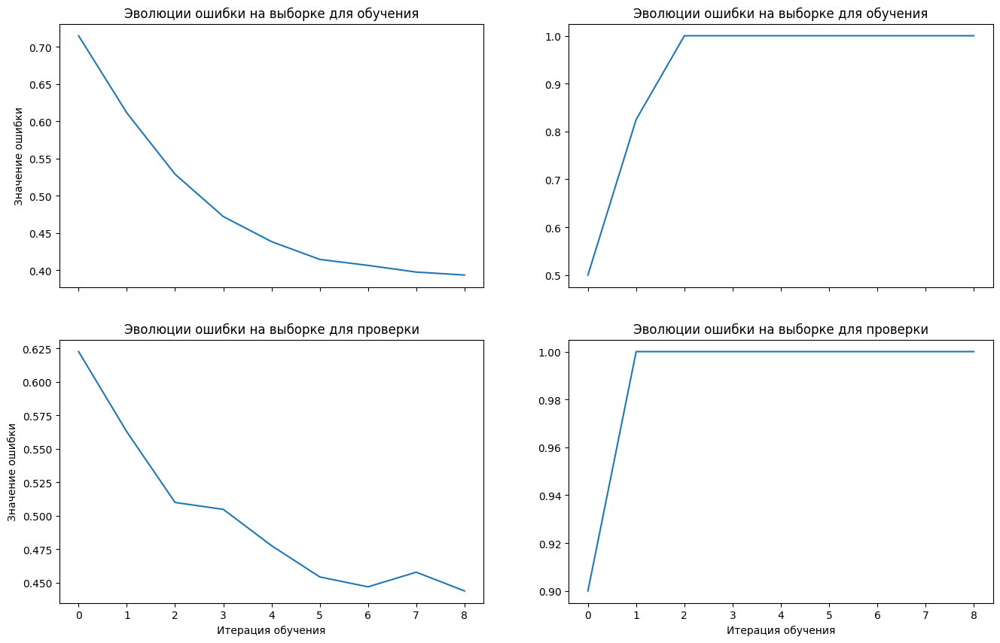

In [ ]:
fig, axs = plt.subplots(2,2, figsize=(16,10), sharex=True)
axs[0,0].plot(process['train']['loss'])
axs[0,0].title.set_text('Эволюции ошибки на выборке для обучения')
axs[0,1].plot(process['train']['accuracy'])
axs[0,1].title.set_text('Эволюции ошибки на выборке для обучения')
axs[1,0].plot(process['validate']['loss'])
axs[1,0].title.set_text('Эволюции ошибки на выборке для проверки')
axs[1,1].plot(process['validate']['accuracy'])
axs[1,1].title.set_text('Эволюции ошибки на выборке для проверки')
axs[1,0].set_xlabel('Итерация обучения')
axs[1,1].set_xlabel('Итерация обучения')
axs[0,0].set_ylabel('Значение ошибки')
axs[1,0].set_ylabel('Значение ошибки')

По графикам видим, что ошибка минимизирована.

В итоге на тренировочном датасете ошибки отсутствуют, несмотря на некоторые "проблемные" изображения. А точность тестового датасета составила 64%.

In [ ]:
(64+56+67+60+67+67+64+62+67+67)/10

64.1